# Deep Convolutional Generative Adversarial Network (DCGAN) Tutorial with PyTorch

## Welcome to this Comprehensive Student Tutorial!

Hello! This Jupyter notebook is a detailed, student-friendly adaptation of the original tutorial from [DebuggerCafe: Implementing Deep Convolutional GAN (DCGAN) with PyTorch](https://debuggercafe.com/dcgan-pytorch/). We've transformed the blog post into an interactive notebook format to make learning easier. 

This tutorial assumes you have basic knowledge of Python, PyTorch, and neural networks. If you're new to GANs, consider reviewing the original GAN paper by Goodfellow et al. (2014) first.

### What You'll Learn
- The foundations of DCGAN from the seminal 2016 paper.
- Architectural details and hyperparameters for stable training.
- Hands-on implementation using PyTorch on the CIFAR-10 dataset.
- Training tips, troubleshooting, and visualization.
- Extensions and exercises to deepen your understanding.

### Prerequisites
- **PyTorch**: Use version 1.4.0 for compatibility (torch==1.4.0, torchvision==0.5.0). Newer versions may require minor adjustments.
- **Hardware**: GPU recommended (use Google Colab if needed).
- **Libraries**: `torch`, `torchvision`, `matplotlib`, `numpy`.
- Install with: `pip install torch==1.4.0 torchvision==0.5.0 matplotlib numpy`

### Notebook Structure
1. **Paper Overview**: Key concepts from the DCGAN paper.
2. **Architecture Deep Dive**: Generator and Discriminator designs.
3. **Implementation**: Code for models, utils, and training.
4. **Training and Evaluation**: Run the training loop and visualize results.
5. **Exercises**: Try it yourself!

Run cells sequentially (Shift+Enter). Let's dive in! 🚀

## 1. Paper Overview: Unsupervised Representation Learning with DCGAN

The DCGAN paper ([arXiv:1511.06434](https://arxiv.org/pdf/1511.06434.pdf)) by Radford, Metz, and Chintala (2016) introduced convolutional architectures to GANs, making them more stable and powerful for image generation.

### Key Contributions
- **Stable Training for Conv GANs**: Guidelines for architecture and hyperparameters to avoid mode collapse and vanishing gradients.
- **Unsupervised Feature Learning**: Trained discriminators perform well on classification tasks without labels.
- **Controllable Generation**: Generators can produce specific objects and manipulate semantics (e.g., smiles on faces).

### Why DCGAN?
- Replaces fully connected layers with convolutions for spatial hierarchy.
- Uses transposed convolutions in the generator for upsampling.
- Batch normalization stabilizes training.

**Student Note**: Read the paper's abstract and Section 2 for architecture. Think: How does convolution help in capturing image textures better than MLPs?

### Datasets in the Paper
- LSUN, ImageNet, Faces (large-scale).
- **Our Choice**: CIFAR-10 (60k 32x32 RGB images, 10 classes) – smaller, accessible, yet challenging.

## 2. Architecture Deep Dive

DCGAN is fully convolutional: No pooling or FC layers!

### Generator (G)
- **Input**: 100D noise vector `z` (reshaped to 100x1x1).
- **Layers**: 5 Transposed Conv2D (deconvolutions) with BatchNorm + ReLU (Tanh at output).
- **Output**: 3x64x64 fake images (we'll resize CIFAR-10 to 64x64).
- Strides: 1 (first), 2 (others) for upsampling.

![Generator Architecture](https://docs.pytorch.org/tutorials/_images/dcgan_generator.png) 

*(From paper: Noise → 512ch → 256ch → 128ch → 64ch → 3ch)*

### Discriminator (D)
- **Input**: 3x64x64 real/fake images.
- **Layers**: 5 Conv2D with BatchNorm + LeakyReLU, stride 2 for downsampling.
- **Output**: Sigmoid probability (real=1, fake=0).
- Slope of LeakyReLU: 0.2.

### Architectural Guidelines
| Guideline | Description | Why? |
|-----------|-------------|------|
| No MaxPooling | Use strided convs | Learn spatial downsampling. |
| BatchNorm | In both G & D (except D output) | Stabilize activations, reduce init sensitivity. |
| Activations | ReLU (G except output), LeakyReLU (D), Tanh (G output) | Avoid dead ReLUs; Tanh for [-1,1] images. |
| No FC Layers | Fully conv | Preserve spatial info. |

### Hyperparameters for Stable Training
| Param | Value | Notes |
|-------|-------|-------|
| Batch Size | 128 | Balances gradient estimates. |
| Latent Dim (nz) | 100 | Noise vector size. |
| LR (Adam) | 0.0002 | With β1=0.5, β2=0.999. |
| Weight Init | N(0, 0.02) | Zero-centered normal. |
| Image Size | 64x64 | Resized from CIFAR-10. |

**Student Tip**: Experiment with β1 (try 0.9 vs 0.5) – lower helps in GANs by reducing momentum on stale gradients.

## 3. Implementation

We'll build modular code: models, utils, trainer.

First, imports and setup.

In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils.data as data
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import os
from PIL import Image

# Set device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Hyperparameters
nz = 100  # Latent vector size
ngf = 64  # Generator feature maps
ndf = 64  # Discriminator feature maps
num_epochs = 50  # For demo; use 50+ for good results
lr = 0.0002
beta1 = 0.5
batch_size = 128
image_size = 64
workers = 2
nc = 3  # RGB channels

# Create output dir
os.makedirs("outputs", exist_ok=True)

print("Setup complete!")

Using device: cuda:0
Setup complete!


### 3.1 Generator Model

Transposed convolutions upsample noise to images.

**Student Note**: `nn.ConvTranspose2d` is key – it learns filters to expand features. Visualize shapes with `torchsummary` if curious.

In [25]:
class Generator(nn.Module):
    def __init__(self, nz, ngf=64, nc=3):  # ngf=64 implies *16=1024 for initial projection, *8=512, *4=256, *2=128, *1=64
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # Diagram Block: Input (100z x 1 x 1) -> Project and Reshape
            # Projects latent vector z via fully connected layer, applies ReLU, then reshapes to spatial feature map
            nn.Linear(nz, ngf * 16 * 4 * 4),  # 100 -> 1024 * 4 * 4 = 16384 (flattened)
            nn.ReLU(True),  # Activation after projection
            nn.Unflatten(1, (ngf * 16, 4, 4)),  # Reshape to 1024 x 4 x 4 (matches diagram's initial feature map)
            
            # Diagram Block: CONV1 (1024 x 4 x 4 -> 512 x 8 x 8, stride=2)
            # First transposed conv block: Upsamples spatially while reducing channels
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),  # 1024 -> 512 x 8 x 8
            nn.BatchNorm2d(ngf * 8),  # Normalize features
            nn.ReLU(True),  # Activation
            
            # Diagram Block: CONV2 (512 x 8 x 8 -> 256 x 16 x 16, stride=2)
            # Second transposed conv block
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),  # 512 -> 256 x 16 x 16
            nn.BatchNorm2d(ngf * 4),  # Normalize
            nn.ReLU(True),  # Activation
            
            # Diagram Block: CONV3 (256 x 16 x 16 -> 128 x 32 x 32, stride=2)
            # Third transposed conv block
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),  # 256 -> 128 x 32 x 32
            nn.BatchNorm2d(ngf * 2),  # Normalize
            nn.ReLU(True),  # Activation
            
            # Diagram Block: CONV4 (128 x 32 x 32 -> 64 x 64 x 64, stride=2)
            # Fourth transposed conv block: Final upsampling to target resolution
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),  # 128 -> 64 x 64 x 64
            nn.BatchNorm2d(ngf),  # Normalize
            nn.ReLU(True),  # Activation
            
            # Diagram Block: Output G(z) (64 x 64 x 64 -> 3 x 64 x 64)
            # Final convolution (non-transposed) to produce RGB image channels at target size
            # Uses regular Conv2d with padding to maintain spatial dimensions exactly
            nn.Conv2d(ngf, nc, kernel_size=3, stride=1, padding=1, bias=False),  # 64 -> 3 x 64 x 64 (k=3, p=1 preserves size)
            nn.Tanh()  # Output activation: Maps to [-1, 1] for normalized images
        )

    def forward(self, input):
        # Expects input as [batch, nz, 1, 1]; flattens for linear projection
        return self.main(input.view(input.size(0), -1))  # Flatten batch for Linear

# Test forward pass
netG = Generator(nz).to(device)
noise = torch.randn(1, nz, 1, 1, device=device)
fake = netG(noise)
print(f"Generator output shape: {fake.shape}")
# Should be torch.Size([1, 3, 64, 64])

Generator output shape: torch.Size([1, 3, 64, 64])


In [24]:
class Generator(nn.Module):
    def __init__(self, nz, ngf=64, nc=3):  # ngf=64 implies *16=1024, *8=512, *4=256, *2=128, *1=64
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # Diagram Block: "Project and reshape" - Projects latent vector z (nz x 1 x 1) to initial feature map
            nn.Linear(nz, ngf * 16 * 4 * 4),  # 100z -> 1024*4*4 = 16384 (flattened)
            nn.ReLU(True),
            nn.Unflatten(1, (ngf * 16, 4, 4)),  # Reshape to 1024 x 4 x 4 (matches diagram's starting tensor after projection)
            
            # Diagram Block: CONV1 - First upsampling transposed conv layer
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),  # 1024 -> 512 x 8 x 8 (stride=2 upsamples 4x4 to 8x8)
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            
            # Diagram Block: CONV2 - Second upsampling transposed conv layer
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),  # 512 -> 256 x 16 x 16 (stride=2 upsamples 8x8 to 16x16)
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            # Diagram Block: CONV3 - Third upsampling transposed conv layer
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),  # 256 -> 128 x 32 x 32 (stride=2 upsamples 16x16 to 32x32)
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            # Diagram Block: CONV4 - Fourth upsampling transposed conv layer (to full spatial size)
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),  # 128 -> 64 x 64 x 64 (stride=2 upsamples 32x32 to 64x64; matches diagram's final feature map size)
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            # Additional Block: Final channel projection to image channels (implied in diagram as output G(z), adjusted for nc=3 RGB)
            nn.ConvTranspose2d(ngf, nc, 4, 1, 0, bias=False),  # 64 -> 3 x 64 x 64 (stride=1, pad=0 preserves 64x64 size; Tanh for [-1,1] pixel range)
            nn.Tanh()
        )

    def forward(self, input):
        # Flatten input batch for linear projection (nz x 1 x 1 -> nz flattened)
        return self.main(input.view(input.size(0), -1))

# Test forward pass
netG = Generator(nz).to(device)
noise = torch.randn(1, nz, 1, 1, device=device)
fake = netG(noise)
print(f"Generator output shape: {fake.shape}")
# Should be torch.Size([1, 3, 64, 64])

Generator output shape: torch.Size([1, 3, 67, 67])


### 3.2 Discriminator Model

Strided convolutions downsample to a scalar probability.

**Math Reminder**: D outputs p(real|image). Loss: Binary Cross-Entropy.

In [26]:
class Discriminator(nn.Module):
    def __init__(self, nc=3, ndf=64):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # Input: nc x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # State: ndf x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # State: (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
            # Output: 1 x 1 x 1
        )

    def forward(self, input):
        return self.main(input).view(-1)

# Test
netD = Discriminator(nc).to(device)
real_img = torch.randn(1, 3, 64, 64, device=device)
pred = netD(real_img)
print(f"Discriminator output shape: {pred.shape}")
# Should be torch.Size([1])

Discriminator output shape: torch.Size([1])


### 3.3 Data Loading: CIFAR-10

Resize to 64x64, normalize to [-1,1] (matches Tanh).

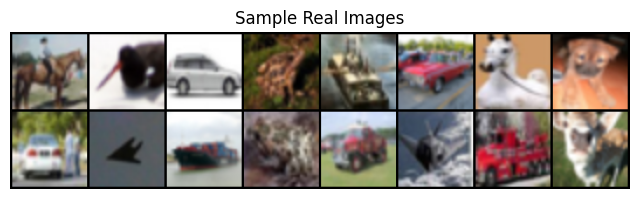

In [27]:
# Data transforms
transform = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),  # To [-1,1]
])

# Dataset and Dataloader
dataset = datasets.CIFAR10(root="input/data", download=True, train=True, transform=transform)
dataloader = data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)

# Visualize sample
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Sample Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0][:16], padding=2, normalize=True), (1,2,0)))
plt.show()

### 3.4 Utility Functions

Weights init, losses, image saving.

In [28]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

# Apply init
netG.apply(weights_init)
netD.apply(weights_init)

# Loss and Optimizers
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1, device=device)  # For visualization
real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

print("Utils ready!")

Utils ready!


## 4. Training the DCGAN

Alternate updates: Train D on real/fake, then G to fool D.

**Pro Tip**: Monitor losses – D loss ~log(4) (0.693*2), G loss ~log(4) when balanced. If G loss drops too low, D is weak.

In [29]:
# Training Loop
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        # Update D: maximize log(D(real)) + log(1 - D(G(z)))
        netD.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = netD(real_cpu).view(-1)
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach()).view(-1)
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        # Update G: maximize log(D(G(z)))
        netG.zero_grad()
        label.fill_(real_label)  # Fake labels are real for G
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Save losses
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        if i % 50 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}] Loss_D: {errD.item():.4f} Loss_G: {errG.item():.4f} D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f}')

        iters += 1

    # Save generated images
    with torch.no_grad():
        fake = netG(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

print("Training complete!")

Starting Training Loop...


[0/50][0/391] Loss_D: 2.4021 Loss_G: 5.7905 D(x): 0.8053 D(G(z)): 0.8230
[0/50][50/391] Loss_D: 0.4418 Loss_G: 6.2508 D(x): 0.7781 D(G(z)): 0.0190
[0/50][100/391] Loss_D: 1.4612 Loss_G: 2.6820 D(x): 0.5839 D(G(z)): 0.4755
[0/50][150/391] Loss_D: 0.8214 Loss_G: 2.2460 D(x): 0.6524 D(G(z)): 0.2477
[0/50][200/391] Loss_D: 0.4255 Loss_G: 5.3760 D(x): 0.8451 D(G(z)): 0.1817
[0/50][250/391] Loss_D: 0.4707 Loss_G: 5.1056 D(x): 0.6850 D(G(z)): 0.0207
[0/50][300/391] Loss_D: 0.2925 Loss_G: 6.3335 D(x): 0.9284 D(G(z)): 0.1791
[0/50][350/391] Loss_D: 0.4462 Loss_G: 3.8268 D(x): 0.8218 D(G(z)): 0.1668
[1/50][0/391] Loss_D: 0.3412 Loss_G: 4.8472 D(x): 0.9137 D(G(z)): 0.2104
[1/50][50/391] Loss_D: 0.9348 Loss_G: 3.1627 D(x): 0.5039 D(G(z)): 0.0333
[1/50][100/391] Loss_D: 0.2761 Loss_G: 4.5998 D(x): 0.8890 D(G(z)): 0.1273
[1/50][150/391] Loss_D: 0.4724 Loss_G: 4.4620 D(x): 0.8073 D(G(z)): 0.1943
[1/50][200/391] Loss_D: 0.1801 Loss_G: 3.6881 D(x): 0.9211 D(G(z)): 0.0815
[1/50][250/391] Loss_D: 0.4722 

### 4.1 Visualize Training Progress

GIF of generated samples over epochs.

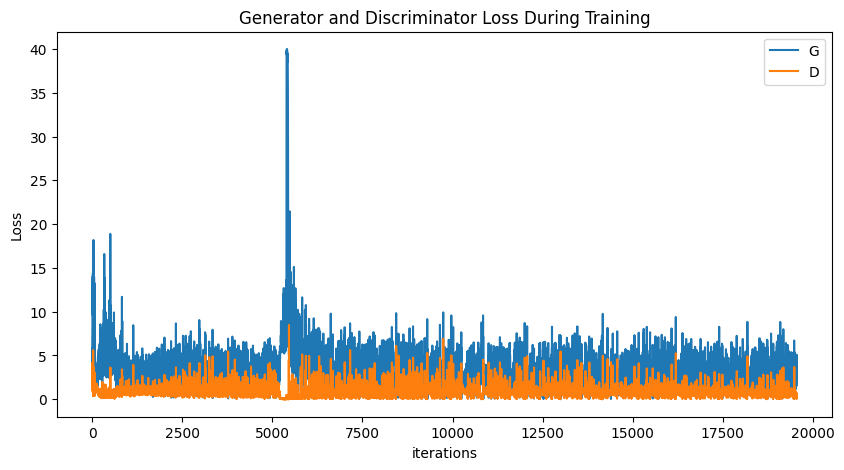

Animation size has reached 20982457 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


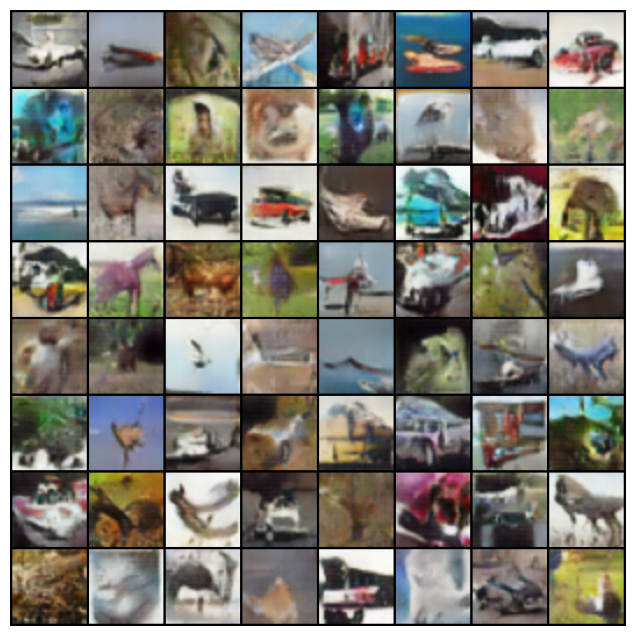

In [30]:
# Plot losses
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses, label="G")
plt.plot(D_losses, label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Animate images
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

## 5. Exercises & Extensions

1. **Hyperparam Tuning**: Change `beta1` to 0.9 and retrain for 10 epochs. Compare losses.
2. **Latent Space Exploration**: Generate images with interpolated noise: `torch.lerp(noise1, noise2, t)` for t in [0,1]. Visualize.
3. **Conditional DCGAN**: Modify G/D to take class labels (use CIFAR labels). Hint: Concat labels to noise/images.
4. **Evaluation Metrics**: Implement FID score using `torch-fidelity` (install if possible). Why is it better than visual inspection?
5. **Debug Mode Collapse**: If samples look similar, add label smoothing to D targets (e.g., 0.9 instead of 1.0).

**Challenge**: Train on MNIST (grayscale) – adjust `nc=1`, resize to 64x64. Compare to CIFAR-10 results.

### Next Steps
- Read StyleGAN paper for advanced control.
- Try DCGAN on your own dataset (e.g., CelebA faces).
- Explore PyTorch Lightning for cleaner training code.

Congratulations! You've implemented DCGAN. Share your generated images on social media. 🎉

**References**:
- Original Tutorial: [DebuggerCafe](https://debuggercafe.com/dcgan-pytorch/)
- DCGAN Paper: [arXiv](https://arxiv.org/pdf/1511.06434.pdf)
- PyTorch GAN Examples: [Official Repo](https://github.com/pytorch/examples/tree/main/dcgan)

In [ ]:
# Save models (optional)
torch.save(netG.state_dict(), "outputs/generator.pth")
torch.save(netD.state_dict(), "outputs/discriminator.pth")
print("Models saved!")